In [1]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import easygems.healpix as egh
import numpy as np
import xarray as xr

/home/users/mmuetz/miniforge3/envs/hackathon_env/lib/python3.12/site-packages/pyproj/network.py:59: UserWarning: pyproj unable to set PROJ database path.
  _set_context_ca_bundle_path(ca_bundle_path)


In [36]:
url1 = 'http://hackathon-o.s3.jc.rl.ac.uk/sim-data/DYAMOND3_example_data/sample_data_hirerarchy/5km-RAL3/data.2d.z10.zarr'
#url2 = 'http://hackathon-o.s3.jc.rl.ac.uk//sim-data/DYAMOND3_example_data/experimental/5km-RAL3/data.test_rldt_nans2.2d.z10.zarr'
url2 = 'http://hackathon-o.s3.jc.rl.ac.uk/sim-data/DYAMOND3_example_data/5km-RAL3/2d/data.2d.z10.zarr'
ds1 = xr.open_zarr(url1)
ds2 = xr.open_zarr(url2)


In [37]:
ds1.tas.isel(time=slice(40)).mean(dim='cell').compute()

<xarray.DataArray 'tas' (time: 40)> Size: 320B
array([285.60609303, 285.52214924, 285.50771777, 285.59330515,
       285.68762792, 285.80911028, 285.93203828, 286.0521878 ,
       286.15905248, 286.22789176, 286.26801885, 286.28713801,
       286.29407518, 286.290923  , 286.27622078, 286.23489772,
       286.16062042, 286.0666171 , 285.96825876, 285.88874637,
       285.81599795, 285.74218477, 285.66388055, 285.59189868,
       285.54357227,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan,
                nan,          nan,          nan,          nan])
Coordinates:
  * time     (time) datetime64[ns] 320B 2020-01-20 ... 2020-01-21T15:00:00

In [38]:
tas_mean_vals = ds2.rlut.isel(time=slice(250)).mean(dim='cell').compute()

In [39]:
tas_mean_vals.values

array([236.72395673, 239.23839533, 236.27053721, 235.36929189,
       235.14859019, 235.16300274, 235.27800779, 235.39964283,
       235.34517778, 235.28344791, 235.3329972 , 235.35494637,
       235.3296236 , 235.17563067, 234.982459  , 234.78794713,
       234.68617127, 234.59156341, 234.44975465, 234.33325132,
       234.24083219, 234.17713916, 234.08699404, 234.03425996,
       234.06561411, 234.13479249, 234.32517868, 234.54056063,
       234.65307611, 234.79372058, 235.00219988, 235.23664898,
       235.4370353 , 235.60051864, 235.72392092, 235.75743825,
       235.70854574, 235.60441411, 235.35974417, 235.0501336 ,
       234.86604977, 234.69971464, 234.57152892, 234.43741875,
       234.31318375, 234.29742439, 234.26712119, 234.1724001 ,
       234.10514677, 234.10341614, 234.2403085 , 234.37408459,
       234.4638075 , 234.60433294, 234.77895766, 234.96434642,
       235.12102758, 235.24152135, 235.29235681, 235.24006366,
       235.17147538, 235.06399536, 234.89749731, 234.71

In [40]:

ds2.time.values[:250][np.isnan(tas_mean_vals.values)]

array(['2020-01-26T16:00:00.000000000', '2020-01-26T17:00:00.000000000',
       '2020-01-26T18:00:00.000000000', '2020-01-26T19:00:00.000000000',
       '2020-01-26T20:00:00.000000000', '2020-01-26T21:00:00.000000000',
       '2020-01-26T22:00:00.000000000', '2020-01-26T23:00:00.000000000',
       '2020-01-27T00:00:00.000000000', '2020-01-27T01:00:00.000000000',
       '2020-01-27T02:00:00.000000000', '2020-01-27T03:00:00.000000000',
       '2020-01-27T04:00:00.000000000', '2020-01-27T05:00:00.000000000',
       '2020-01-27T06:00:00.000000000', '2020-01-27T07:00:00.000000000',
       '2020-01-27T08:00:00.000000000', '2020-01-27T09:00:00.000000000',
       '2020-01-27T10:00:00.000000000', '2020-01-27T11:00:00.000000000',
       '2020-01-27T12:00:00.000000000', '2020-01-27T13:00:00.000000000',
       '2020-01-27T14:00:00.000000000', '2020-01-27T15:00:00.000000000',
       '2020-01-27T16:00:00.000000000', '2020-01-27T17:00:00.000000000',
       '2020-01-27T18:00:00.000000000', '2020-01-27

In [41]:
for t, v in zip(ds2.time.values[:250], np.isnan(tas_mean_vals.values)):
    print(t, not v)

2020-01-20T00:00:00.000000000 True
2020-01-20T01:00:00.000000000 True
2020-01-20T02:00:00.000000000 True
2020-01-20T03:00:00.000000000 True
2020-01-20T04:00:00.000000000 True
2020-01-20T05:00:00.000000000 True
2020-01-20T06:00:00.000000000 True
2020-01-20T07:00:00.000000000 True
2020-01-20T08:00:00.000000000 True
2020-01-20T09:00:00.000000000 True
2020-01-20T10:00:00.000000000 True
2020-01-20T11:00:00.000000000 True
2020-01-20T12:00:00.000000000 True
2020-01-20T13:00:00.000000000 True
2020-01-20T14:00:00.000000000 True
2020-01-20T15:00:00.000000000 True
2020-01-20T16:00:00.000000000 True
2020-01-20T17:00:00.000000000 True
2020-01-20T18:00:00.000000000 True
2020-01-20T19:00:00.000000000 True
2020-01-20T20:00:00.000000000 True
2020-01-20T21:00:00.000000000 True
2020-01-20T22:00:00.000000000 True
2020-01-20T23:00:00.000000000 True
2020-01-21T00:00:00.000000000 True
2020-01-21T01:00:00.000000000 True
2020-01-21T02:00:00.000000000 True
2020-01-21T03:00:00.000000000 True
2020-01-21T04:00:00.

In [45]:
import numpy as np
np.isnan(ds1.tas.isel(time=1).compute()).sum(), np.isnan(ds2.tas.isel(time=1).compute()).sum()

(<xarray.DataArray 'tas' ()> Size: 8B
 array(2521)
 Coordinates:
     time     datetime64[ns] 8B 2020-01-20T01:00:00,
 <xarray.DataArray 'tas' ()> Size: 8B
 array(0)
 Coordinates:
     time     datetime64[ns] 8B 2020-01-20T01:00:00)

In [6]:
#import numpy as np
#for name, da in ds.data_vars.items():
#    timename = [c for c in da.coords if c.startswith('time')][0]
#    print(ds[timename].values[[0, 29]])
#    print(name, da.attrs['long_name'], (~np.isnan(da.isel(**{timename: slice(30)}).mean(dim='cell').compute().values)).sum())
    

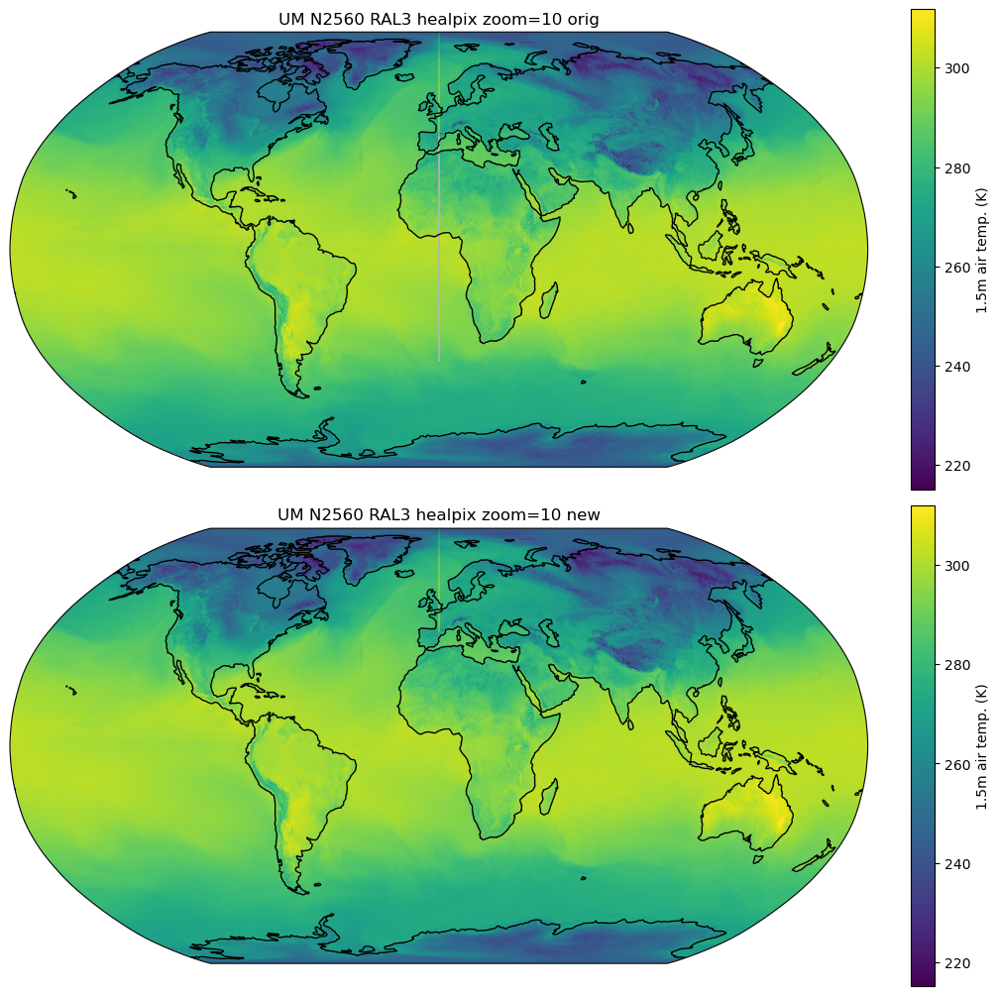

In [46]:


data1 = ds1.tas.isel(time=1).compute()
projection = ccrs.Robinson(central_longitude=0)
fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(10, 10), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 healpix zoom={zoom} orig')
ax0.set_global()
im = egh.healpix_show(data1.values, ax=ax0);
plt.colorbar(im, label='1.5m air temp. (K)')
ax0.coastlines();

data2 = ds2.tas.isel(time=1).compute()
ax1.set_title(f'UM N2560 RAL3 healpix zoom={zoom} new')
ax1.set_global()
im = egh.healpix_show(data2.values, ax=ax1);
plt.colorbar(im, label='1.5m air temp. (K)')
ax1.coastlines();

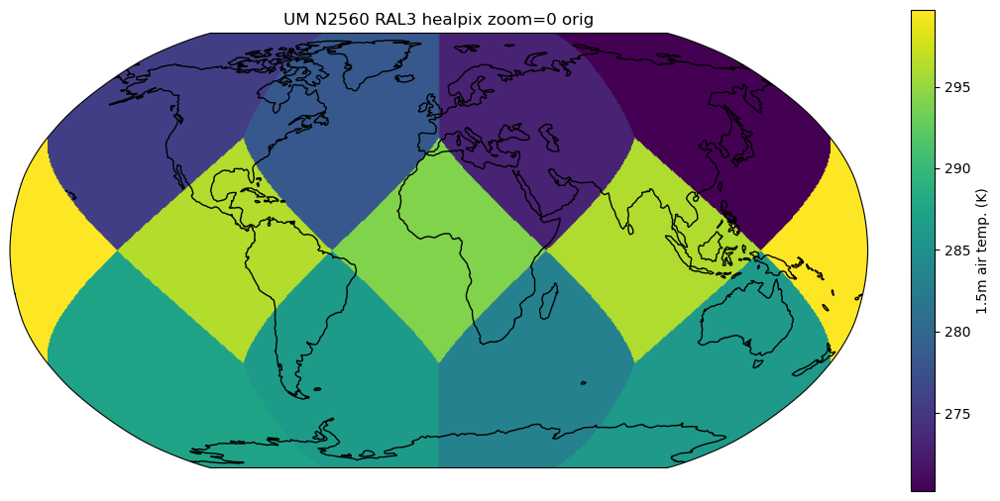

In [53]:
z = 0
urlz = f'http://hackathon-o.s3.jc.rl.ac.uk//sim-data/DYAMOND3_example_data/experimental/5km-RAL3/data.full5.2d.z{z}.zarr'
dsz = xr.open_zarr(urlz)

data1 = dsz.tas.isel(time=1).compute()
projection = ccrs.Robinson(central_longitude=0)
fig, ax0 = plt.subplots(1, 1, figsize=(10, 5), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 healpix zoom={z} orig')
ax0.set_global()
im = egh.healpix_show(data1.values, ax=ax0);
plt.colorbar(im, label='1.5m air temp. (K)')
ax0.coastlines();

In [26]:
t0 = ds2.tas.isel(time=0).compute()

In [28]:
import numpy as np
np.isnan(t0).sum()

<xarray.DataArray 'tas' ()> Size: 8B
array(1024)
Coordinates:
    time     datetime64[ns] 8B 2020-01-20

In [29]:
import healpix as hp

In [30]:
nside = hp.order2nside(10)
npix = hp.nside2npix(nside)

hp_lon, hp_lat = hp.pix2ang(nside=nside, ipix=np.arange(npix), lonlat=True, nest=True)

In [31]:
t0.shape

(12582912,)

In [32]:
hp_lon.shape

(12582912,)

In [36]:
(hp_lon[np.isnan(t0)] == 0).all()

np.True_

In [55]:
hp_lat[np.isnan(t0)].min()

np.float64(-41.76028861947634)

In [38]:
(hp_lon == 0).sum()

np.int64(1024)

In [41]:
(hp_lon[hp_lon != 0] % 360).min()

np.float64(0.0439453125)

In [14]:
rmse(data1.values, data2.values)

np.float64(0.0)

In [51]:
len(list(ds.data_vars.items()))

24

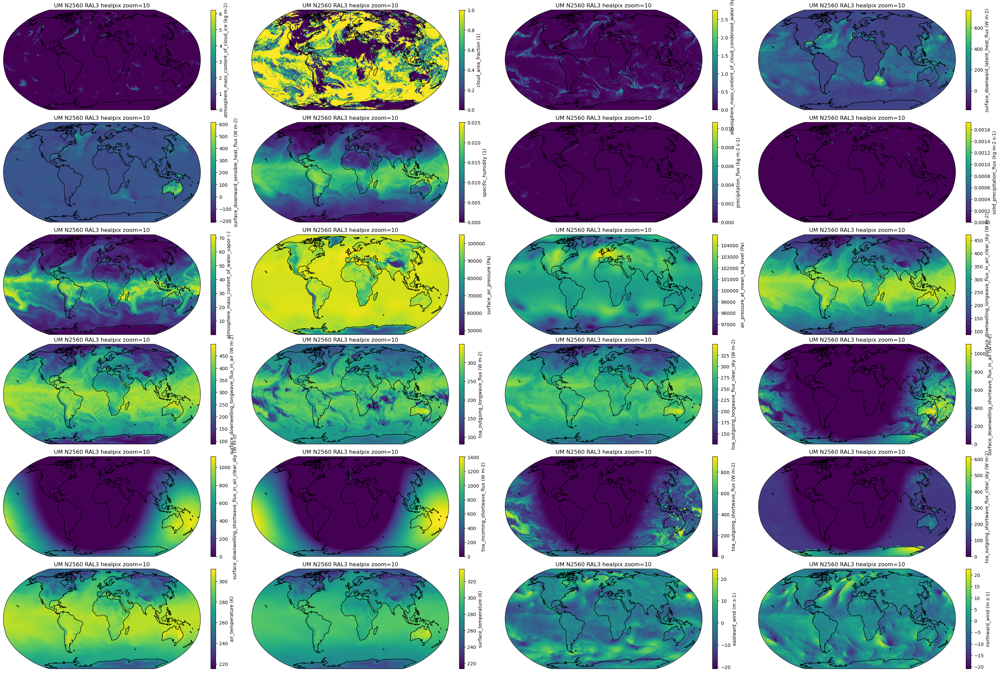

In [56]:
zoom = 10
projection = ccrs.Robinson(central_longitude=0)

fig, axes = plt.subplots(6, 4, figsize=(30, 20), subplot_kw={'projection': projection}, layout='constrained')

for ax, (name, da) in zip(axes.flatten(), ds2.data_vars.items()):
    #print(name)
    timename = [c for c in da.coords if c.startswith('time')][0]
    data = da.isel(**{timename: 1})
    ax.set_title(f'UM N2560 RAL3 healpix zoom={zoom}')
    ax.set_global()
    im = egh.healpix_show(data.values, ax=ax);
    # TODO!!!! Temp fix
    #if da.long_name.startswith('toa_outgoing') and 'longwave' in da.long_name:
    #    long_name = da.long_name.replace('longwave', 'shortwave')
    #elif da.long_name.startswith('toa_outgoing') and 'shortwave' in da.long_name:
    #    long_name = da.long_name.replace('shortwave', 'longwave')
    #else:
    #    long_name = da.long_name
    long_name = da.long_name
        
    plt.colorbar(im, label=f'{long_name} ({da.attrs.get("units", "-")})')
    ax.coastlines();    

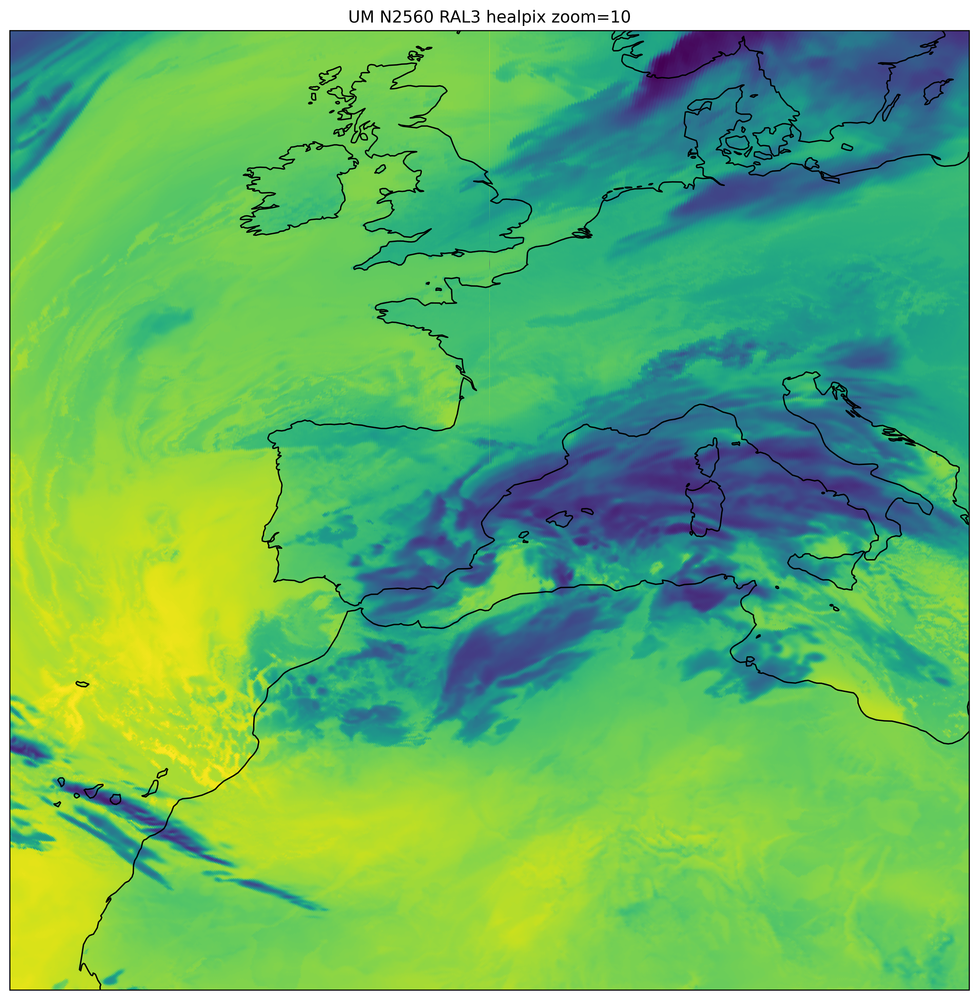

In [60]:
data = ds2.rlut.isel(time=5)
projection = ccrs.PlateCarree()
fig, ax0 = plt.subplots(1, 1, figsize=(10, 10), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 healpix zoom={zoom}')
#ax0.set_global()
#ax0.set_xlim((-2, 2))
#ax0.set_ylim((41, 43))
ax0.set_xlim((-20, 20))
ax0.set_ylim((20, 60))
im = egh.healpix_show(data.values, ax=ax0, dpi=500);
#plt.colorbar(im, label='1.5m air temp. (K)')
ax0.coastlines();

In [61]:
url_input_data = 'http://hackathon-o.s3.jc.rl.ac.uk/sim-data/DYAMOND3_example_data/sim-data/DYAMOND3_example_data/sample_data_hirerarchy/5km-RAL3/input_data.2d.zarr'
ds_indat = xr.open_zarr(url_input_data)

/tmp/ipykernel_555/1079606155.py:2: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds_indat = xr.open_zarr(url_input_data)


In [62]:
ds_indat

<xarray.Dataset> Size: 1GB
Dimensions:                  (time_0: 13, latitude: 3840, longitude: 5120)
Coordinates:
    forecast_period_0        (time_0) timedelta64[ns] 104B dask.array<chunksize=(13,), meta=np.ndarray>
    forecast_reference_time  datetime64[ns] 8B ...
    height                   float64 8B ...
    height_0                 float64 8B ...
  * latitude                 (latitude) float32 15kB -89.98 -89.93 ... 89.98
  * longitude                (longitude) float32 20kB 0.03516 0.1055 ... 360.0
  * time_0                   (time_0) datetime64[ns] 104B 2020-01-20T00:02:00...
Data variables:
    air_temperature          (time_0, latitude, longitude) float32 1GB dask.array<chunksize=(2, 480, 640), meta=np.ndarray>

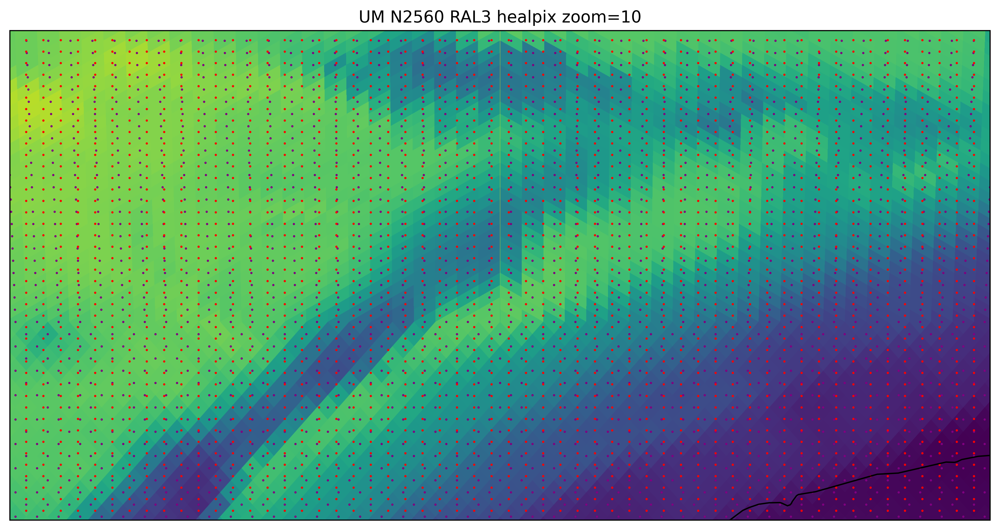

In [70]:
data = ds2.rlut.isel(time=5)
projection = ccrs.PlateCarree()
fig, ax0 = plt.subplots(1, 1, figsize=(10, 10), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 healpix zoom={zoom}')
ax0.set_global()
ax0.set_xlim((-2, 2))
ax0.set_ylim((41, 43))
#ax0.set_xlim((-20, 20))
#ax0.set_ylim((20, 60))
im = egh.healpix_show(data.values, ax=ax0, dpi=500);
ax0.scatter(hp_lon, hp_lat, s=0.4, c='purple')
lon = ds_indat.longitude.values
lat = ds_indat.latitude.values
Lat, Lon = np.meshgrid(lat, lon)
ax0.scatter(Lon.flatten(), Lat.flatten(), s=0.4, c='red')

#plt.colorbar(im, label='1.5m air temp. (K)')
ax0.coastlines();

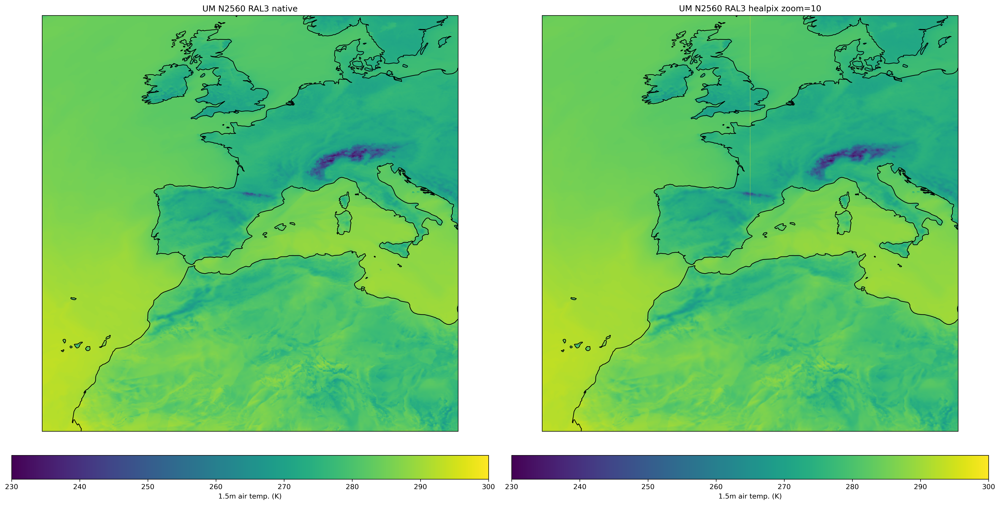

In [80]:
projection = ccrs.PlateCarree()
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 native')
#ax0.set_global()
#ax0.set_xlim((-2, 2))
#ax0.set_ylim((41, 43))
ax0.set_xlim((-20, 20))
ax0.set_ylim((20, 60))
im = ax0.pcolormesh(ds_indat.longitude, ds_indat.latitude, ds_indat.air_temperature.isel(time_0=1), vmin=230, vmax=300)
plt.colorbar(im, label='1.5m air temp. (K)', orientation='horizontal')
ax0.coastlines();

data = ds2.tas.isel(time=1)
ax1.set_title(f'UM N2560 RAL3 healpix zoom={zoom}')
#ax0.set_global()
#ax0.set_xlim((-2, 2))
#ax0.set_ylim((41, 43))
ax1.set_xlim((-20, 20))
ax1.set_ylim((20, 60))
im = egh.healpix_show(data.values, ax=ax1, dpi=300, vmin=230, vmax=300);
plt.colorbar(im, label='1.5m air temp. (K)', orientation='horizontal')
ax1.coastlines();

In [ ]:
projection = ccrs.PlateCarree()
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(20, 10), subplot_kw={'projection': projection}, layout='constrained')
zoom = 10
ax0.set_title(f'UM N2560 RAL3 native')
#ax0.set_global()
ax0.set_xlim((-2, 2))
ax0.set_ylim((41, 43))
#ax0.set_xlim((-20, 20))
#ax0.set_ylim((20, 60))
im = ax0.pcolormesh(ds_indat.longitude, ds_indat.latitude, ds_indat.air_temperature.isel(time_0=1), vmin=230, vmax=300)
plt.colorbar(im, label='1.5m air temp. (K)', orientation='horizontal')
ax0.coastlines();

data = ds2.tas.isel(time=1)
ax1.set_title(f'UM N2560 RAL3 healpix zoom={zoom}')
#ax0.set_global()
ax1.set_xlim((-2, 2))
ax1.set_ylim((41, 43))
#ax1.set_xlim((-20, 20))
#ax1.set_ylim((20, 60))
im = egh.healpix_show(data.values, ax=ax1, dpi=300, vmin=230, vmax=300);
plt.colorbar(im, label='1.5m air temp. (K)', orientation='horizontal')
ax1.coastlines();

In [75]:
ds2.tas.isel(time=1).time


<xarray.DataArray 'time' ()> Size: 8B
array('2020-01-20T01:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    time     datetime64[ns] 8B 2020-01-20T01:00:00

In [77]:
ds_indat.isel(time_0=1).time_0

<xarray.DataArray 'time_0' ()> Size: 8B
array('2020-01-20T01:00:00.000000000', dtype='datetime64[ns]')
Coordinates:
    forecast_period_0        timedelta64[ns] 8B dask.array<chunksize=(), meta=np.ndarray>
    forecast_reference_time  datetime64[ns] 8B ...
    height                   float64 8B ...
    height_0                 float64 8B ...
    time_0                   datetime64[ns] 8B 2020-01-20T01:00:00
Attributes:
    axis:           T
    standard_name:  time

In [2]:
import numpy as np
import xarray as xr

In [5]:
zoom = 10
ds = xr.open_zarr(f'http://hackathon-o.s3.jc.rl.ac.uk/sim-data/DYAMOND3_example_data/5km-RAL3/3d/data.full.v3.3d.z{zoom}.zarr')

In [7]:
ds.sel(pressure=500)

<xarray.Dataset> Size: 4TB
Dimensions:   (cell: 12582912, time: 3497)
Coordinates:
  * cell      (cell) int64 101MB 0 1 2 3 ... 12582908 12582909 12582910 12582911
    pressure  float32 4B 500.0
  * time      (time) datetime64[ns] 28kB 2020-01-20 ... 2021-04-01
Data variables:
    cli       (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    clw       (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    hur       (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    hus       (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    qg        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    qr        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    qs        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    ta        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    ua        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    va        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>
    zg        (time, cell) float64 352GB dask.array<chunksize=(1, 1048576), meta=np.ndarray>

In [28]:
ds.cli

<xarray.DataArray 'cli' (time: 3497, pressure: 25, cell: 12582912)> Size: 9TB
dask.array<open_dataset-cli, shape=(3497, 25, 12582912), dtype=float64, chunksize=(1, 5, 1048576), chunktype=numpy.ndarray>
Coordinates:
  * cell     (cell) int64 101MB 0 1 2 3 ... 12582908 12582909 12582910 12582911
  * time     (time) datetime64[ns] 28kB 2020-01-20 ... 2021-04-01
Dimensions without coordinates: pressure
Attributes:
    UM_name:          mass_fraction_of_cloud_ice_in_air
    coarsened:        False
    grid_mapping:     healpix_nested
    healpix_zoom:     10
    long_name:        mass_fraction_of_cloud_ice_in_air
    regrid_method:    easygems_delaunay
    um_stash_source:  m01s00i012
    units:            kg kg-1

In [30]:
data = ds.cli.isel(time=1).compute()

In [31]:
np.isnan(data).all()

<xarray.DataArray 'cli' ()> Size: 1B
array(False)
Coordinates:
    time     datetime64[ns] 8B 2020-01-20T03:00:00

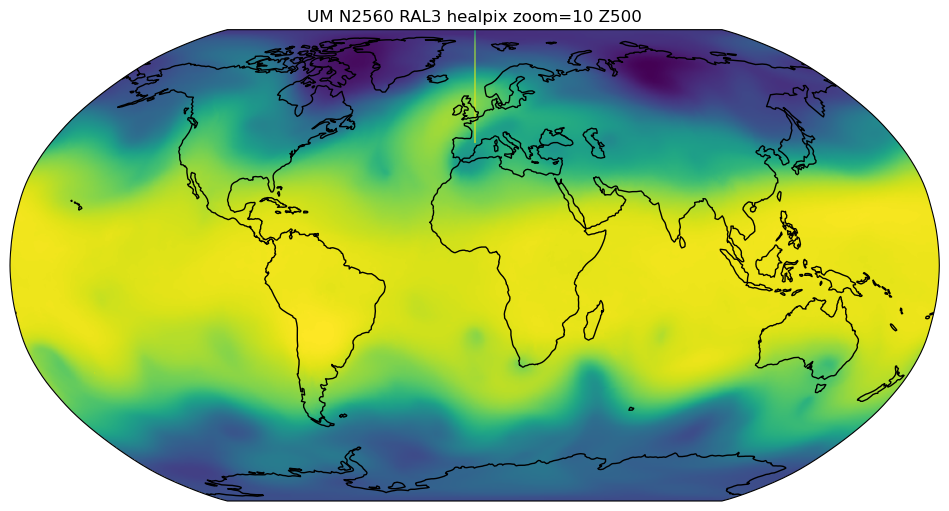

In [39]:
data = ds.zg.isel(time=1).isel(pressure=11).compute()
projection = ccrs.Robinson(central_longitude=0)
fig, ax0 = plt.subplots(1, 1, figsize=(10, 5), subplot_kw={'projection': projection}, layout='constrained')
ax0.set_title(f'UM N2560 RAL3 healpix zoom={zoom} Z500')
ax0.set_global()
im = egh.healpix_show(data.values, ax=ax0);
# plt.colorbar(im, label='1.5m air temp. (K)')
ax0.coastlines();

In [20]:
import pandas as pd

In [23]:
import pandas as pd
pd.date_range('2020-01-20', '2020-01-21', freq='3h')

DatetimeIndex(['2020-01-20 00:00:00', '2020-01-20 03:00:00',
               '2020-01-20 06:00:00', '2020-01-20 09:00:00',
               '2020-01-20 12:00:00', '2020-01-20 15:00:00',
               '2020-01-20 18:00:00', '2020-01-20 21:00:00',
               '2020-01-21 00:00:00'],
              dtype='datetime64[ns]', freq='3h')

In [46]:
sorted([(n, d.long_name) for n, d in ds.data_vars.items()], key=lambda x: x[1])

[('ua', 'eastward_wind'),
 ('zg', 'geopotential height'),
 ('cli', 'mass_fraction_of_cloud_ice_in_air'),
 ('clw', 'mass_fraction_of_cloud_liquid_water_in_air'),
 ('qg', 'mass_fraction_of_graupel_in_air'),
 ('qr', 'mass_fraction_of_rain_in_air'),
 ('qs', 'mass_fraction_of_snow_water_in_air'),
 ('va', 'northtward_wind'),
 ('hur', 'relative_humidity'),
 ('hus', 'specific_humidity'),
 ('ta', 'temperature')]

In [47]:
for short_name, long_name in sorted([(n, da.long_name) for n, da in ds.data_vars.items()], key=lambda x: x[1]):
    print(f'{ds[short_name].long_name},{short_name}')

eastward_wind,ua
geopotential height,zg
mass_fraction_of_cloud_ice_in_air,cli
mass_fraction_of_cloud_liquid_water_in_air,clw
mass_fraction_of_graupel_in_air,qg
mass_fraction_of_rain_in_air,qr
mass_fraction_of_snow_water_in_air,qs
northtward_wind,va
relative_humidity,hur
specific_humidity,hus
temperature,ta
